In [36]:
import os 
import cv2
import time 
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as ans 
from tqdm import tqdm 
import shutil 
import tensorflow as tf 
from tensorflow import keras 
from tensorflow.keras import Model
from tensorflow.keras import layers 
from tensorflow.keras.layers import *
import tensorflow_datasets as tfds
import tensorflow_probability as tfp
from tensorflow.keras.initializers import RandomNormal
from tensorflow.keras import *
from datetime import datetime
from tensorflow.keras.applications.vgg19 import VGG19
from tensorflow.keras.layers import Dense, Input, UpSampling2D, Conv2DTranspose, Conv2D, add, Add,\
                    Lambda, Concatenate, AveragePooling2D, BatchNormalization, GlobalAveragePooling2D, \
                    Add, LayerNormalization, Activation, LeakyReLU
try:
    import tensorflow_addons as tfa 
except:
    !pip install tensorflow_addons
    import tensorflow_addons as tfa
    from tensorflow_addons.layers import InstanceNormalization

In [81]:
BATCH_SIZE = 8
HR_IMG_DIMS = (256, 256, 3)
LR_IMG_DIMS = (64, 64, 3)
NUM_RES_BLOCK = 8
REPEAT_COUNT = None
SCALE = 4 
NUM_FILTERS = 32
N_RES_BLOCKS = 32
RES_BLOCK_SCALIMG = None
RES_BLOCK_EXPANSION_A = 4
RES_BLOCK_EXPANSION_B = 6

DIV2K_RGB_MEAN = np.array([0.4488, 0.4371, 0.4040]) * 255

In [38]:
div2k = tfds.image.Div2k(config='bicubic_x4')
div2k.download_and_prepare()

# train data
train_ds = div2k.as_dataset(split='train',as_supervised=True)  # 800 hr and 800 lr images
# validation data
val_ds = div2k.as_dataset(split='validation',as_supervised=True)  # 100 hr and 199 lr images

In [39]:
def random_crop(lr_img, hr_img, scale=4):
    ''' This function crops lr(64*64) and hr(256*256) images'''
    lr_crop_size = HR_IMG_DIMS[0] // scale
    lr_img_shape = tf.shape(lr_img)[:2]

    lr_width = tf.random.uniform(shape=(), maxval=LR_IMG_DIMS[1] - lr_crop_size + 1, dtype=tf.int32)
    lr_height = tf.random.uniform(shape=(), maxval=LR_IMG_DIMS[0] - lr_crop_size + 1, dtype=tf.int32)

    hr_width = lr_width * scale
    hr_height = lr_height * scale

    lr_img_cropped = lr_img[lr_height:lr_height + lr_crop_size, lr_width:lr_width + lr_crop_size]
    hr_img_cropped = hr_img[hr_height:hr_height + HR_IMG_DIMS[0], hr_width:hr_width + HR_IMG_DIMS[0]]

    return lr_img_cropped, hr_img_cropped

def random_flip(lr_img, hr_img):
    ''' This function will flip imag left_right randomly'''
    random = tf.random.uniform(shape=(), maxval=1)
    return tf.cond(random < 0.5,lambda: (lr_img, hr_img),
                   lambda: (tf.image.flip_left_right(lr_img),
                            tf.image.flip_left_right(hr_img)))
        
def random_rotate(lr_img, hr_img):
    ''' This function will rotate image randomly to 90 degree'''
    rand = tf.random.uniform(shape=(), maxval=4, dtype=tf.int32)
    return tf.image.rot90(lr_img, rand), tf.image.rot90(hr_img, rand)

In [40]:
def data_augmentation(lr_img, hr_img):
    lr_img = tf.cast(lr_img, tf.float32)
    hr_img = tf.cast(hr_img, tf.float32)
    lr_img, hr_img = random_crop(lr_img, hr_img)
    lr_img, hr_img = random_rotate(lr_img, hr_img)
    lr_img, hr_img = random_flip(lr_img, hr_img)
    
    return lr_img, hr_img

In [41]:
train_ds = train_ds.map(data_augmentation, num_parallel_calls=tf.data.AUTOTUNE)
train_ds = train_ds.batch(BATCH_SIZE)
train_ds = train_ds.prefetch(tf.data.AUTOTUNE)
train_ds

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, None, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, None, None, 3), dtype=tf.float32, name=None))>

In [42]:
val_ds = val_ds.repeat(1)
val_ds = val_ds.batch(1)
val_ds = val_ds.prefetch(tf.data.AUTOTUNE)
val_ds

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(None, None, None, 3), dtype=tf.uint8, name=None))>

(64, 64, 3)


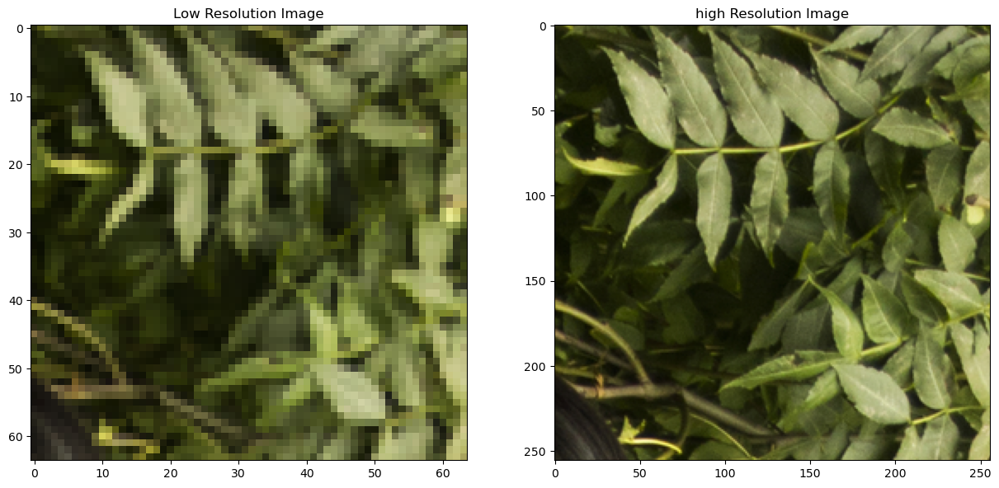

In [43]:
sample_data = next(iter(train_ds))
lr_sample_image = sample_data[0][0]
hr_sample_image = sample_data[1][0]
print(lr_sample_image.shape)

lr_sample_image = tf.reshape(lr_sample_image, (64, 64, 3))
hr_sample_image = tf.reshape(hr_sample_image, (256, 256, 3))

plt.figure(figsize=(15, 15))
plt.subplot(1, 2, 1)
plt.imshow(lr_sample_image/ 255.0)
plt.title("Low Resolution Image")

plt.subplot(1, 2, 2)
plt.imshow(hr_sample_image/ 255.0)
plt.title("high Resolution Image")

del sample_data

In [44]:
def residual_block(x_input, num_filters, scaling):
    x = Conv2D(num_filters, 3, padding='same', activation='relu')(x_input)
    x = Conv2D(num_filters, 3, padding='same')(x)
    if scaling:
        x = Lambda(lambda t: t * scaling)(x)
    x = Add()([x_input, x])
    return x

In [45]:
def upsampling_block(apply_bn=False, apply_dropout=False,
                     filters=256, kernel_size=(3, 3), upsamling_size=2):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(Conv2D(filters, kernel_size, padding="same"))
    result.add(UpSampling2D(size = upsamling_size))
    
    if apply_bn:
        result.add(tf.keras.layers.BatchNormalization())

    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))

    result.add(tf.keras.layers.PReLU())

    return result

In [46]:
def upsampling(x, scale, num_filters):
    def upsample(x, factor, **kwargs):
        x = Conv2D(num_filters * (factor ** 2), 3, padding='same', **kwargs)(x)
        return Lambda(shuffle_pixels(scale=factor))(x)

    if scale == 2:
        x = upsample(x, 2)
    elif scale == 3:
        x = upsample(x, 3)
    elif scale == 4:
        x = upsample(x, 2)
        x = upsample(x, 2)

    return x

In [47]:
def normalize(x,rgb_mean=DIV2K_RGB_MEAN):
    return (x - rgb_mean) / 127.5

def denormalize(x,rgb_mean=DIV2K_RGB_MEAN):
    return (x * 127.5 )+ rgb_mean

def shuffle_pixels(scale):
    return lambda x: tf.nn.depth_to_space(x, scale)

In [48]:
def res_block_a(x_in, num_filters, expansion, kernel_size, scaling):
    x = conv2d_weightnorm(num_filters * expansion, kernel_size, padding='same', activation='relu')(x_in)
    x = conv2d_weightnorm(num_filters, kernel_size, padding='same')(x)
    if scaling:
        x = Lambda(lambda t: t * scaling)(x)
    x = Add()([x_in, x])
    return x

In [49]:
def res_block_b(x_in, num_filters, expansion, kernel_size, scaling):
    linear = 0.8
    x = conv2d_weightnorm(num_filters * expansion, 1, padding='same', activation='relu')(x_in)
    x = conv2d_weightnorm(int(num_filters * linear), 1, padding='same')(x)
    x = conv2d_weightnorm(num_filters, kernel_size, padding='same')(x)
    if scaling:
        x = Lambda(lambda t: t * scaling)(x)
    x = Add()([x_in, x])
    return x

In [50]:
def conv2d_weightnorm(filters, kernel_size, padding='same', activation=None, **kwargs):
    return tfp.layers.weight_norm.WeightNorm(Conv2D(filters,
                                                    kernel_size,
                                                    padding=padding,
                                                    activation=activation,
                                                    **kwargs), 
                                             data_init=False)

In [51]:
def get_wdsr(scale, num_filters, num_res_blocks, res_block_expansion, res_block_scaling, res_block):
    """
        this function used to create the WDSR model, which is a derivate of the EDSR model.
        Params:
            scale                  : It use at the end of residual blocks for slim mapping and also use in 
                                          original input to make size same as residual block output and then add it.
            num_filterss           : Number of filters in conv of residual block.
            res_block_expansion    : a slim identity mapping pathway with wider (2× to 4×) channels 
                                       before activation in each residual block.
            res_block_scaling      : whether you can to scale residual block or not
            res_block              : use res_block_a for WDSR-A and res_block_b for WDSR-B network
    
    """

    x_input = Input(shape=(None, None, 3))
    x = Lambda(normalize)(x_input)

    # main branch
    main_branch = conv2d_weightnorm(num_filters, 3, padding='same')(x)
    for i in range(num_res_blocks):
        main_branch = res_block(main_branch, num_filters, res_block_expansion, kernel_size=3, scaling=res_block_scaling)
    main_branch = conv2d_weightnorm(3 * scale ** 2, 3, padding='same', name=f'conv2d_main_scale_{scale}')(main_branch)
    main_branch = Lambda(shuffle_pixels(scale))(main_branch)

    # skip branch
    s = conv2d_weightnorm(3 * scale ** 2, 5, padding='same', name=f'conv2d_skip_scale_{scale}')(x)
    s = Lambda(shuffle_pixels(scale))(s)

    x = Add()([main_branch, s])
    x = Lambda(denormalize)(x)

    return Model(x_input, x, name="WDSR")
  

In [52]:
def get_wdsr_a(scale, num_filters, num_res_blocks, res_block_expansion, res_block_scaling):
    return get_wdsr(scale, num_filters, num_res_blocks, res_block_expansion, res_block_scaling, res_block_a)

def get_wdsr_b(scale, num_filters, num_res_blocks, res_block_expansion, res_block_scaling):
    return get_wdsr(scale, num_filters, num_res_blocks, res_block_expansion, res_block_scaling, res_block_b)
  

In [24]:
wdsr_a = get_wdsr_a(SCALE, NUM_FILTERS, NUM_RES_BLOCK, RES_BLOCK_EXPANSION_A, RES_BLOCK_SCALIMG)
tf.keras.utils.plot_model(wdsr_a, to_file="wdsr_a.png")
wdsr_a.summary()

Model: "WDSR"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 lambda_13 (Lambda)             (None, None, None,   0           ['input_5[0][0]']                
                                3)                                                                
                                                                                                  
 weight_norm_57 (WeightNorm)    (None, None, None,   929         ['lambda_13[0][0]']              
                                32)                                                            

In [94]:
class WDSRTrainer(keras.models.Model): 
    def __init__(self, wdsr_model):
        super(WDSRTrainer, self).__init__()
        self.wdsr_loss_tracker = tf.keras.metrics.Mean()
        
        self.wdsr_model = wdsr_model
        
        self.summary_writer = tf.summary.create_file_writer(
        "logs/" + "fit/" + datetime.now().strftime("%Y%m%d-%H%M%S"))
    
    @property
    def metrics(self):
        pass 
    
    def call(self, inputs):
        sr = self.edsr_model(inputs)
        return sr

    def train_step(self, inputs):
        lr_img, hr_img = inputs
        
        with tf.GradientTape(persistent=True) as tape:
            # generate the super resolution image
            hr_edsr_img = self.wdsr_model(lr_img, training=True)
            
            # loss
            loss_val = self.compiled_loss(hr_img, hr_edsr_img)

        # Params
        params = self.wdsr_model.trainable_weights
        
        # grads
        grads = tape.gradient(loss_val, params)
        
        # Back Propagate
        self.optimizer.apply_gradients(zip(grads, params))
        
        # loss tracker
        self.wdsr_loss_tracker.update_state(loss_val)

        #with self.summary_writer.as_default():
        #tf.summary.scalar('gen_total_loss', total_gen_loss, step=step//1000)
        #tf.summary.scalar('gen_gan_loss', gan_loss, step=step//1000)
        #tf.summary.scalar('gen_l1_loss', l1_loss, step=step//1000)
        #tf.summary.scalar('disc_loss', total_disc_loss, step=step//1000)
        return {
                "loss": self.wdsr_loss_tracker.result(), 
               }
    
    def test_step(self, val_ds):
        psnr_val = self.get_psnr(val_ds)
        ssim_val = self.get_ssim(val_ds)
        
        return psnr_val, ssim_val
    
    def compute_loss(self, hr, sr):
        loss_func = tf.keras.metrics.MeanAbsoluteError()
        loss = loss_func(hr, sr)
        return loss
    
    def get_psnr(self, ds):
        psnr_values = []
        for lr, hr in ds:
            # convert dtype to float32
            lr = tf.cast(lr, tf.float32)
            # get sr image from model
            sr = self.wdsr_model(lr)
            # clip values to 0,255
            sr = tf.clip_by_value(sr, 0, 255)
            # round up values
            sr = tf.round(sr)
            # change dtype to unint8
            sr = tf.cast(sr, tf.uint8)
            # get psnr value
            psnr_value = tf.image.psnr(hr, sr, max_val=255)[0]
            # append psnr value
            psnr_values.append(psnr_value)
        return tf.reduce_mean(psnr_values)
    
    def get_ssim(self, ds):
        ssim_values = []
        for lr,hr in ds:
            # convert dtype to float32
            lr = tf.cast(lr, tf.float32)
            # get sr image from model
            sr = self.wdsr_model(lr)
            # clip values to 0,255
            sr = tf.clip_by_value(sr, 0, 255)
            # round up values
            sr = tf.round(sr)
            # change dtype to unint8
            sr = tf.cast(sr, tf.uint8)
            # get ssim value
            ssim_value = tf.image.ssim(hr, sr, max_val=255).numpy()[0]
            # append ssim value
            ssim_values.append(ssim_value)
        return tf.reduce_mean(ssim_values)
    
    def get_mos(self, ds):
        pass 

In [79]:
wdsr_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [55]:
wdsr_model = get_wdsr_a(SCALE, NUM_FILTERS, NUM_RES_BLOCK, RES_BLOCK_EXPANSION_A, RES_BLOCK_SCALIMG)

In [56]:
model = WDSRTrainer(wdsr_model)
model.compile(loss=tf.keras.losses.MeanAbsoluteError(), optimizer=wdsr_optimizer)

In [57]:
ckpt = tf.train.Checkpoint(step=tf.Variable(1),
                           edsr_optimizer=wdsr_optimizer,
                           model=model,
                           psnr=tf.Variable(-1.0),
                           ssim = tf.Variable(-1.0)
                          )
manager = tf.train.CheckpointManager(ckpt, './tf_ckpts_wdsr', max_to_keep=3)

In [58]:
def train(model, train_ds, test_ds, epochs, manager):
    loss_list = []
    psnr_list = []
    ssim_list = []
    
    ckpt.restore(manager.latest_checkpoint)
    if manager.latest_checkpoint:
        print("Restored from {}".format(manager.latest_checkpoint))
    else:
        print("Initializing from scratch.")
    
    for epoch in range(epochs):
        for step, train_data_batch in tqdm(enumerate(train_ds), total=len(train_ds)):
            result = model.train_step(train_data_batch)
            loss = result.get("loss")
            
            ckpt.step.assign_add(1)
            
        # test step
        psnr_val, ssim_val = model.test_step(test_ds)
        psnr_list.append(psnr_val)
        ssim_list.append(ssim_val)
        
        if psnr_val > ckpt.psnr: 
            save_path = manager.save()
            ckpt.psnr = psnr_val
            print("Saved checkpoint for step {}: {}".format(int(ckpt.step), save_path))
        
        loss_list.append(loss)
        m_psnr_val = np.mean(psnr_list)
        m_ssim_val = np.mean(ssim_list)
        
        print(f"Epochs: {epoch}, loss: {loss}, PSNR: {m_psnr_val}, SSIM: {m_ssim_val}")
    return model

In [60]:
train(model, train_ds, val_ds.take(10), 50, manager)

Restored from ./tf_ckpts_wdsr/ckpt-1


100%|██████████| 100/100 [01:21<00:00,  1.23it/s]


Saved checkpoint for step 201: ./tf_ckpts_wdsr/ckpt-2
Epochs: 0, loss: 18.471620559692383, PSNR: 21.59158706665039, SSIM: 0.4288133978843689


100%|██████████| 100/100 [01:17<00:00,  1.30it/s]


Saved checkpoint for step 301: ./tf_ckpts_wdsr/ckpt-3
Epochs: 1, loss: 15.958725929260254, PSNR: 22.264175415039062, SSIM: 0.4842020273208618


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 401: ./tf_ckpts_wdsr/ckpt-4
Epochs: 2, loss: 14.329963684082031, PSNR: 22.68900489807129, SSIM: 0.5119438767433167


100%|██████████| 100/100 [01:16<00:00,  1.30it/s]


Saved checkpoint for step 501: ./tf_ckpts_wdsr/ckpt-5
Epochs: 3, loss: 13.134408950805664, PSNR: 23.031639099121094, SSIM: 0.5291630029678345


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 601: ./tf_ckpts_wdsr/ckpt-6
Epochs: 4, loss: 12.239066123962402, PSNR: 23.334280014038086, SSIM: 0.551910400390625


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 701: ./tf_ckpts_wdsr/ckpt-7
Epochs: 5, loss: 11.509597778320312, PSNR: 23.58631134033203, SSIM: 0.5685775876045227


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 801: ./tf_ckpts_wdsr/ckpt-8
Epochs: 6, loss: 10.933934211730957, PSNR: 23.80074691772461, SSIM: 0.583799421787262


100%|██████████| 100/100 [01:19<00:00,  1.25it/s]


Saved checkpoint for step 901: ./tf_ckpts_wdsr/ckpt-9
Epochs: 7, loss: 10.440007209777832, PSNR: 23.986473083496094, SSIM: 0.594709038734436


100%|██████████| 100/100 [01:16<00:00,  1.30it/s]


Saved checkpoint for step 1001: ./tf_ckpts_wdsr/ckpt-10
Epochs: 8, loss: 10.016854286193848, PSNR: 24.15442657470703, SSIM: 0.6054847240447998


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 1101: ./tf_ckpts_wdsr/ckpt-11
Epochs: 9, loss: 9.655088424682617, PSNR: 24.30400276184082, SSIM: 0.6144808530807495


100%|██████████| 100/100 [01:17<00:00,  1.29it/s]


Saved checkpoint for step 1201: ./tf_ckpts_wdsr/ckpt-12
Epochs: 10, loss: 9.338125228881836, PSNR: 24.43928337097168, SSIM: 0.623091459274292


100%|██████████| 100/100 [01:15<00:00,  1.32it/s]


Saved checkpoint for step 1301: ./tf_ckpts_wdsr/ckpt-13
Epochs: 11, loss: 9.057064056396484, PSNR: 24.56183433532715, SSIM: 0.6315319538116455


100%|██████████| 100/100 [01:17<00:00,  1.29it/s]


Saved checkpoint for step 1401: ./tf_ckpts_wdsr/ckpt-14
Epochs: 12, loss: 8.807331085205078, PSNR: 24.67416763305664, SSIM: 0.6384433507919312


100%|██████████| 100/100 [01:23<00:00,  1.20it/s]


Saved checkpoint for step 1501: ./tf_ckpts_wdsr/ckpt-15
Epochs: 13, loss: 8.584755897521973, PSNR: 24.778079986572266, SSIM: 0.645114541053772


100%|██████████| 100/100 [01:20<00:00,  1.24it/s]


Saved checkpoint for step 1601: ./tf_ckpts_wdsr/ckpt-16
Epochs: 14, loss: 8.383560180664062, PSNR: 24.874223709106445, SSIM: 0.6511961817741394


100%|██████████| 100/100 [01:17<00:00,  1.30it/s]


Saved checkpoint for step 1701: ./tf_ckpts_wdsr/ckpt-17
Epochs: 15, loss: 8.198938369750977, PSNR: 24.963233947753906, SSIM: 0.6565231084823608


100%|██████████| 100/100 [01:17<00:00,  1.28it/s]


Saved checkpoint for step 1801: ./tf_ckpts_wdsr/ckpt-18
Epochs: 16, loss: 8.031078338623047, PSNR: 25.044706344604492, SSIM: 0.6614433526992798


100%|██████████| 100/100 [01:15<00:00,  1.32it/s]


Saved checkpoint for step 1901: ./tf_ckpts_wdsr/ckpt-19
Epochs: 17, loss: 7.877736568450928, PSNR: 25.12139892578125, SSIM: 0.6660362482070923


100%|██████████| 100/100 [01:16<00:00,  1.30it/s]


Saved checkpoint for step 2001: ./tf_ckpts_wdsr/ckpt-20
Epochs: 18, loss: 7.734889030456543, PSNR: 25.193479537963867, SSIM: 0.6705750823020935


100%|██████████| 100/100 [01:17<00:00,  1.29it/s]


Saved checkpoint for step 2101: ./tf_ckpts_wdsr/ckpt-21
Epochs: 19, loss: 7.603343486785889, PSNR: 25.260400772094727, SSIM: 0.6743980646133423


100%|██████████| 100/100 [01:17<00:00,  1.29it/s]


Saved checkpoint for step 2201: ./tf_ckpts_wdsr/ckpt-22
Epochs: 20, loss: 7.48069953918457, PSNR: 25.323097229003906, SSIM: 0.6782751083374023


100%|██████████| 100/100 [01:17<00:00,  1.30it/s]


Saved checkpoint for step 2301: ./tf_ckpts_wdsr/ckpt-23
Epochs: 21, loss: 7.3675432205200195, PSNR: 25.38251304626465, SSIM: 0.6817483305931091


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 2401: ./tf_ckpts_wdsr/ckpt-24
Epochs: 22, loss: 7.261922836303711, PSNR: 25.438583374023438, SSIM: 0.6849691271781921


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 2501: ./tf_ckpts_wdsr/ckpt-25
Epochs: 23, loss: 7.163311004638672, PSNR: 25.491409301757812, SSIM: 0.6880486607551575


100%|██████████| 100/100 [01:16<00:00,  1.30it/s]


Saved checkpoint for step 2601: ./tf_ckpts_wdsr/ckpt-26
Epochs: 24, loss: 7.070196628570557, PSNR: 25.54107666015625, SSIM: 0.690903902053833


100%|██████████| 100/100 [01:16<00:00,  1.30it/s]


Saved checkpoint for step 2701: ./tf_ckpts_wdsr/ckpt-27
Epochs: 25, loss: 6.982863903045654, PSNR: 25.588529586791992, SSIM: 0.6937159895896912


100%|██████████| 100/100 [01:17<00:00,  1.29it/s]


Saved checkpoint for step 2801: ./tf_ckpts_wdsr/ckpt-28
Epochs: 26, loss: 6.90032434463501, PSNR: 25.6336669921875, SSIM: 0.696338415145874


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 2901: ./tf_ckpts_wdsr/ckpt-29
Epochs: 27, loss: 6.822582244873047, PSNR: 25.676532745361328, SSIM: 0.6988688111305237


100%|██████████| 100/100 [01:17<00:00,  1.30it/s]


Saved checkpoint for step 3001: ./tf_ckpts_wdsr/ckpt-30
Epochs: 28, loss: 6.749153137207031, PSNR: 25.717439651489258, SSIM: 0.7012277245521545


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 3101: ./tf_ckpts_wdsr/ckpt-31
Epochs: 29, loss: 6.679372310638428, PSNR: 25.756465911865234, SSIM: 0.7033949494361877


100%|██████████| 100/100 [01:16<00:00,  1.30it/s]


Saved checkpoint for step 3201: ./tf_ckpts_wdsr/ckpt-32
Epochs: 30, loss: 6.61277961730957, PSNR: 25.79352569580078, SSIM: 0.7054649591445923


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 3301: ./tf_ckpts_wdsr/ckpt-33
Epochs: 31, loss: 6.550347805023193, PSNR: 25.829524993896484, SSIM: 0.7075022459030151


100%|██████████| 100/100 [01:17<00:00,  1.30it/s]


Saved checkpoint for step 3401: ./tf_ckpts_wdsr/ckpt-34
Epochs: 32, loss: 6.490481376647949, PSNR: 25.86406135559082, SSIM: 0.7095044851303101


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 3501: ./tf_ckpts_wdsr/ckpt-35
Epochs: 33, loss: 6.433756351470947, PSNR: 25.897119522094727, SSIM: 0.7113499641418457


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 3601: ./tf_ckpts_wdsr/ckpt-36
Epochs: 34, loss: 6.379317283630371, PSNR: 25.928768157958984, SSIM: 0.7131364941596985


100%|██████████| 100/100 [01:17<00:00,  1.29it/s]


Saved checkpoint for step 3701: ./tf_ckpts_wdsr/ckpt-37
Epochs: 35, loss: 6.327139854431152, PSNR: 25.959400177001953, SSIM: 0.714758574962616


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 3801: ./tf_ckpts_wdsr/ckpt-38
Epochs: 36, loss: 6.277620315551758, PSNR: 25.989086151123047, SSIM: 0.7164318561553955


100%|██████████| 100/100 [01:17<00:00,  1.28it/s]


Saved checkpoint for step 3901: ./tf_ckpts_wdsr/ckpt-39
Epochs: 37, loss: 6.229962348937988, PSNR: 26.01763153076172, SSIM: 0.7179856300354004


100%|██████████| 100/100 [01:17<00:00,  1.30it/s]


Saved checkpoint for step 4001: ./tf_ckpts_wdsr/ckpt-40
Epochs: 38, loss: 6.184378623962402, PSNR: 26.04511833190918, SSIM: 0.7195122241973877


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 4101: ./tf_ckpts_wdsr/ckpt-41
Epochs: 39, loss: 6.140354633331299, PSNR: 26.07193374633789, SSIM: 0.7210399508476257


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 4201: ./tf_ckpts_wdsr/ckpt-42
Epochs: 40, loss: 6.098063945770264, PSNR: 26.09780502319336, SSIM: 0.7225134372711182


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 4301: ./tf_ckpts_wdsr/ckpt-43
Epochs: 41, loss: 6.057373046875, PSNR: 26.12300682067871, SSIM: 0.7239042520523071


100%|██████████| 100/100 [01:16<00:00,  1.30it/s]


Saved checkpoint for step 4401: ./tf_ckpts_wdsr/ckpt-44
Epochs: 42, loss: 6.0181097984313965, PSNR: 26.14754867553711, SSIM: 0.7252987027168274


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 4501: ./tf_ckpts_wdsr/ckpt-45
Epochs: 43, loss: 5.980724334716797, PSNR: 26.17121124267578, SSIM: 0.7265689373016357


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 4601: ./tf_ckpts_wdsr/ckpt-46
Epochs: 44, loss: 5.944745063781738, PSNR: 26.19424819946289, SSIM: 0.7278393507003784


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 4701: ./tf_ckpts_wdsr/ckpt-47
Epochs: 45, loss: 5.909679412841797, PSNR: 26.216886520385742, SSIM: 0.7291101217269897


100%|██████████| 100/100 [01:15<00:00,  1.32it/s]


Saved checkpoint for step 4801: ./tf_ckpts_wdsr/ckpt-48
Epochs: 46, loss: 5.875448226928711, PSNR: 26.23880386352539, SSIM: 0.730308473110199


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 4901: ./tf_ckpts_wdsr/ckpt-49
Epochs: 47, loss: 5.842833042144775, PSNR: 26.260116577148438, SSIM: 0.7314470410346985


100%|██████████| 100/100 [01:16<00:00,  1.31it/s]


Saved checkpoint for step 5001: ./tf_ckpts_wdsr/ckpt-50
Epochs: 48, loss: 5.811293125152588, PSNR: 26.280921936035156, SSIM: 0.7325517535209656


100%|██████████| 100/100 [01:17<00:00,  1.30it/s]


Saved checkpoint for step 5101: ./tf_ckpts_wdsr/ckpt-51
Epochs: 49, loss: 5.7806854248046875, PSNR: 26.301342010498047, SSIM: 0.7336910963058472


In [ ]:
model.wdsr_model.save('trained_wdsr_a_model.h5')
trained_model = tf.keras.models.load_model("trained_wdsr_a_model.h5")

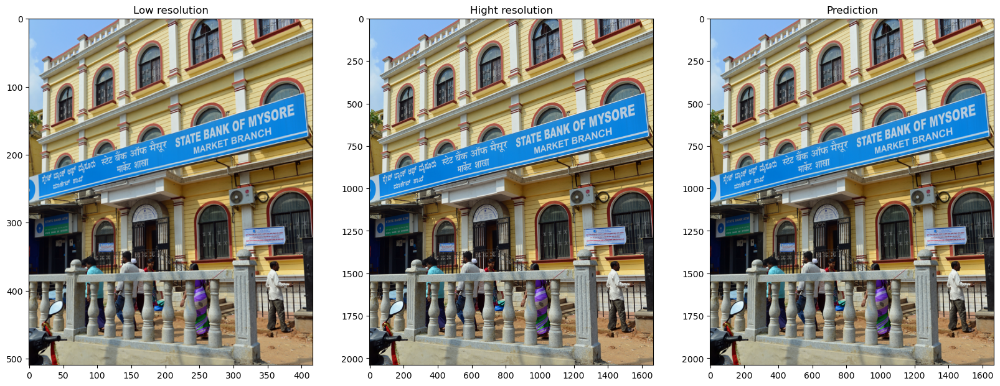

<Figure size 640x480 with 0 Axes>

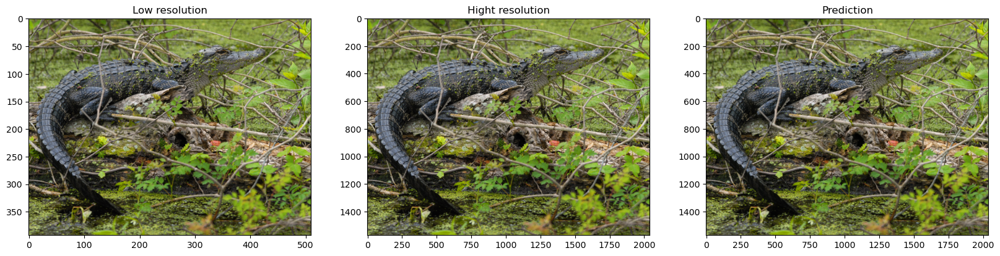

<Figure size 640x480 with 0 Axes>

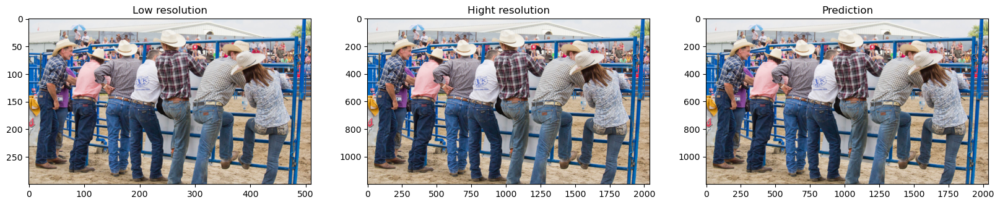

<Figure size 640x480 with 0 Axes>

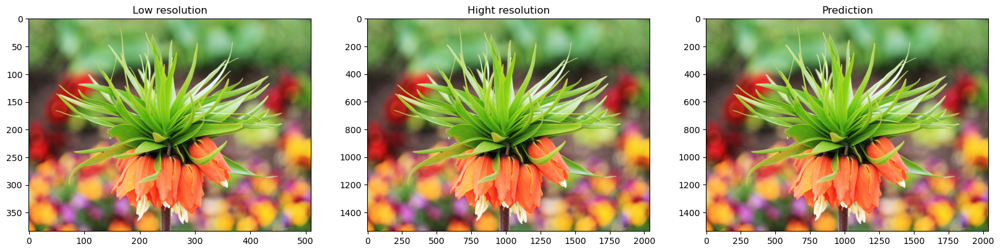

<Figure size 640x480 with 0 Axes>

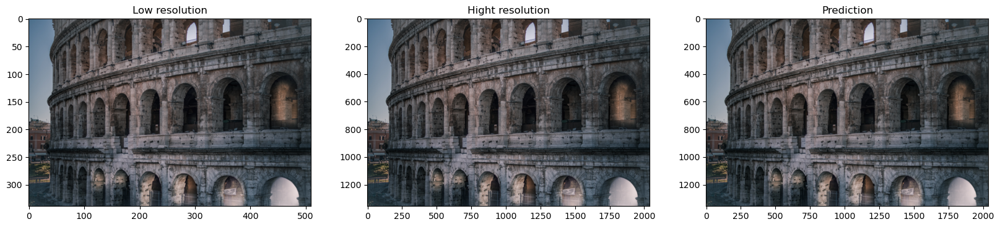

<Figure size 640x480 with 0 Axes>

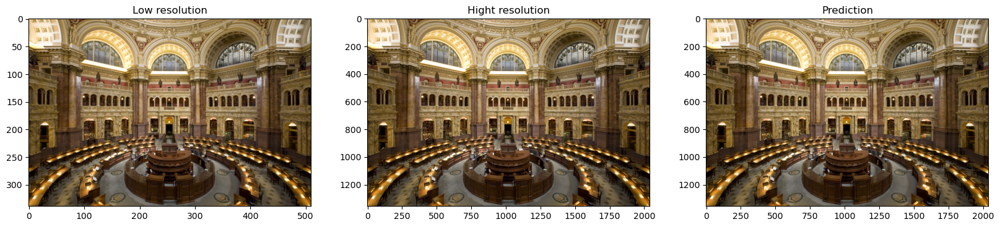

<Figure size 640x480 with 0 Axes>

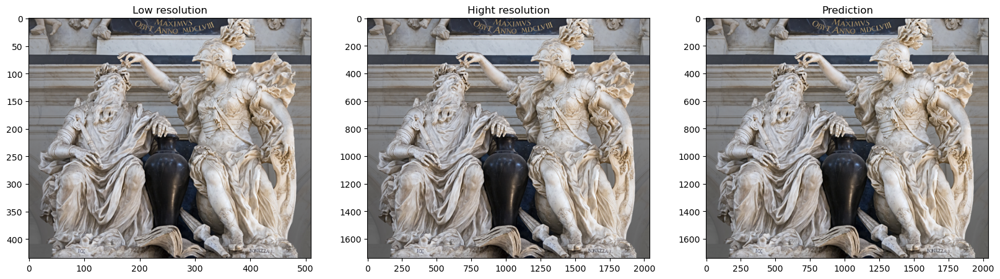

<Figure size 640x480 with 0 Axes>

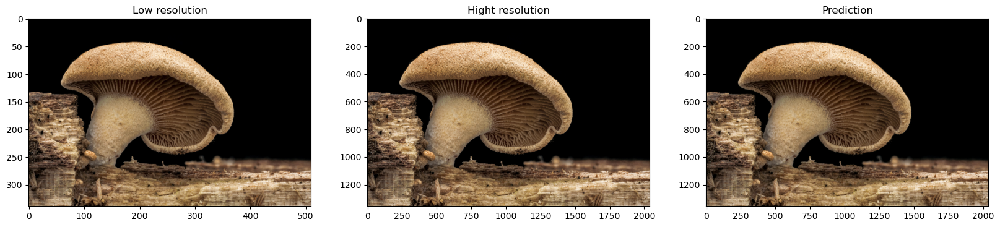

<Figure size 640x480 with 0 Axes>

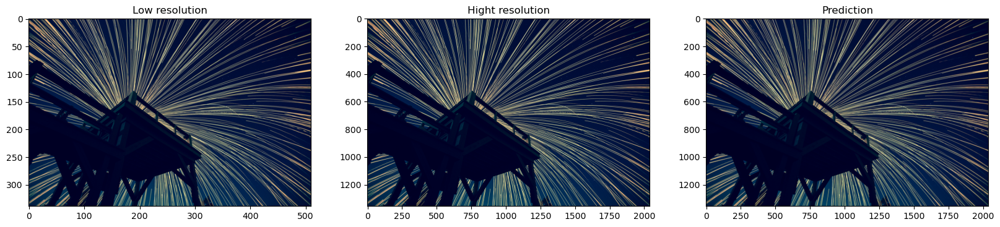

<Figure size 640x480 with 0 Axes>

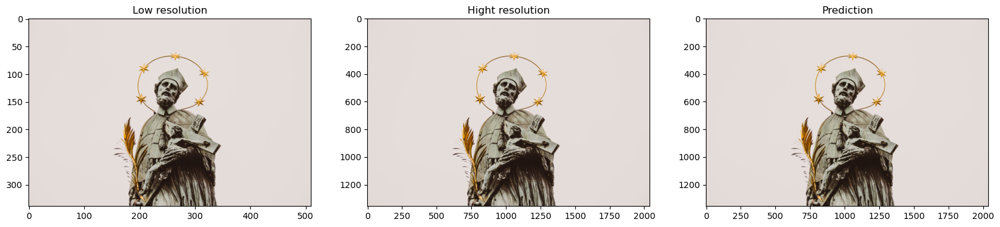

<Figure size 640x480 with 0 Axes>

In [77]:
def plot_results(lowres, preds, highres):
    """
    Displays low resolution image and super resolution image
    """
    plt.figure(figsize=(20, 10))
    plt.subplot(131), plt.imshow(lowres), plt.title("Low resolution")
    plt.subplot(132), plt.imshow(highres), plt.title("Hight resolution")
    plt.subplot(133), plt.imshow(preds/255.0), plt.title("Prediction")
    plt.show()
    plt.savefig("wdsr_a_res.png")

for lr, hr in val_ds.take(10):
    lr = lr[0]
    hr = hr[0]

 #   lowres = tf.image.random_crop(lowres, (64, 64, 3))
    lr = tf.expand_dims(lr, 0)
    sr = model.edsr_model(lr)
    sr = sr[0]
    sr = tf.cast(sr, tf.float32)
    lr = lr[0]
    
    plot_results(lr, sr, hr)

## WDSR_B

In [82]:
wdsr_model = get_wdsr_b(SCALE, NUM_FILTERS, NUM_RES_BLOCK, RES_BLOCK_EXPANSION_B, RES_BLOCK_SCALIMG)

In [95]:
model = WDSRTrainer(wdsr_model)
model.compile(loss=tf.keras.losses.MeanAbsoluteError(), optimizer=wdsr_optimizer)

In [96]:
wdsr_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [97]:
ckpt = tf.train.Checkpoint(step=tf.Variable(1),
                           edsr_optimizer=wdsr_optimizer,
                           model=model,
                           psnr=tf.Variable(-1.0),
                           ssim = tf.Variable(-1.0)
                          )
manager = tf.train.CheckpointManager(ckpt, './tf_ckpts_wdsr_b', max_to_keep=3)

In [102]:
wdsr_b_model = train(model, train_ds, val_ds.take(10), 50, manager)

Restored from ./tf_ckpts_wdsr_b/ckpt-1


100%|██████████| 100/100 [01:22<00:00,  1.21it/s]


Saved checkpoint for step 201: ./tf_ckpts_wdsr_b/ckpt-2
Epochs: 0, loss: 11.526025772094727, PSNR: 22.616201400756836, SSIM: 0.49031296372413635


100%|██████████| 100/100 [01:19<00:00,  1.26it/s]


Saved checkpoint for step 301: ./tf_ckpts_wdsr_b/ckpt-3
Epochs: 1, loss: 10.829681396484375, PSNR: 22.93423080444336, SSIM: 0.5241697430610657


100%|██████████| 100/100 [01:18<00:00,  1.27it/s]


Saved checkpoint for step 401: ./tf_ckpts_wdsr_b/ckpt-4
Epochs: 2, loss: 10.304891586303711, PSNR: 23.19712257385254, SSIM: 0.5426023602485657


100%|██████████| 100/100 [01:24<00:00,  1.18it/s]


Saved checkpoint for step 501: ./tf_ckpts_wdsr_b/ckpt-5
Epochs: 3, loss: 9.869043350219727, PSNR: 23.417694091796875, SSIM: 0.5546424388885498


100%|██████████| 100/100 [01:19<00:00,  1.26it/s]


Saved checkpoint for step 601: ./tf_ckpts_wdsr_b/ckpt-6
Epochs: 4, loss: 9.513880729675293, PSNR: 23.61103630065918, SSIM: 0.5698584318161011


100%|██████████| 100/100 [01:23<00:00,  1.20it/s]


Saved checkpoint for step 701: ./tf_ckpts_wdsr_b/ckpt-7
Epochs: 5, loss: 9.207904815673828, PSNR: 23.779870986938477, SSIM: 0.5795677304267883


100%|██████████| 100/100 [01:32<00:00,  1.08it/s]


Saved checkpoint for step 801: ./tf_ckpts_wdsr_b/ckpt-8
Epochs: 6, loss: 8.936809539794922, PSNR: 23.94085693359375, SSIM: 0.5920979380607605


100%|██████████| 100/100 [01:22<00:00,  1.22it/s]


Saved checkpoint for step 901: ./tf_ckpts_wdsr_b/ckpt-9
Epochs: 7, loss: 8.69425106048584, PSNR: 24.079790115356445, SSIM: 0.6016875505447388


100%|██████████| 100/100 [01:35<00:00,  1.04it/s]


Saved checkpoint for step 1001: ./tf_ckpts_wdsr_b/ckpt-10
Epochs: 8, loss: 8.477255821228027, PSNR: 24.20742416381836, SSIM: 0.6105157136917114


100%|██████████| 100/100 [01:23<00:00,  1.20it/s]


Saved checkpoint for step 1101: ./tf_ckpts_wdsr_b/ckpt-11
Epochs: 9, loss: 8.284307479858398, PSNR: 24.323394775390625, SSIM: 0.6185606718063354


100%|██████████| 100/100 [01:33<00:00,  1.07it/s]


Saved checkpoint for step 1201: ./tf_ckpts_wdsr_b/ckpt-12
Epochs: 10, loss: 8.11231803894043, PSNR: 24.43101692199707, SSIM: 0.6247904896736145


100%|██████████| 100/100 [01:22<00:00,  1.21it/s]


Saved checkpoint for step 1301: ./tf_ckpts_wdsr_b/ckpt-13
Epochs: 11, loss: 7.95672082901001, PSNR: 24.52941131591797, SSIM: 0.6306150555610657


100%|██████████| 100/100 [01:26<00:00,  1.15it/s]


Saved checkpoint for step 1401: ./tf_ckpts_wdsr_b/ckpt-14
Epochs: 12, loss: 7.812009811401367, PSNR: 24.618572235107422, SSIM: 0.635419487953186


100%|██████████| 100/100 [01:22<00:00,  1.21it/s]


Saved checkpoint for step 1501: ./tf_ckpts_wdsr_b/ckpt-15
Epochs: 13, loss: 7.674437999725342, PSNR: 24.70351791381836, SSIM: 0.6413437128067017


100%|██████████| 100/100 [01:27<00:00,  1.14it/s]


Saved checkpoint for step 1601: ./tf_ckpts_wdsr_b/ckpt-16
Epochs: 14, loss: 7.552741050720215, PSNR: 24.78276824951172, SSIM: 0.6464281678199768


100%|██████████| 100/100 [01:26<00:00,  1.16it/s]


Saved checkpoint for step 1701: ./tf_ckpts_wdsr_b/ckpt-17
Epochs: 15, loss: 7.437790870666504, PSNR: 24.856494903564453, SSIM: 0.6511907577514648


100%|██████████| 100/100 [01:26<00:00,  1.16it/s]


Saved checkpoint for step 1801: ./tf_ckpts_wdsr_b/ckpt-18
Epochs: 16, loss: 7.332458972930908, PSNR: 24.924758911132812, SSIM: 0.6558653712272644


100%|██████████| 100/100 [01:22<00:00,  1.21it/s]


Saved checkpoint for step 1901: ./tf_ckpts_wdsr_b/ckpt-19
Epochs: 17, loss: 7.234708786010742, PSNR: 24.99042320251465, SSIM: 0.6596353650093079


100%|██████████| 100/100 [01:30<00:00,  1.10it/s]


Saved checkpoint for step 2001: ./tf_ckpts_wdsr_b/ckpt-20
Epochs: 18, loss: 7.139409065246582, PSNR: 25.05276870727539, SSIM: 0.6637385487556458


100%|██████████| 100/100 [01:23<00:00,  1.20it/s]


Saved checkpoint for step 2101: ./tf_ckpts_wdsr_b/ckpt-21
Epochs: 19, loss: 7.049007892608643, PSNR: 25.112329483032227, SSIM: 0.6676157712936401


100%|██████████| 100/100 [01:19<00:00,  1.26it/s]


Saved checkpoint for step 2201: ./tf_ckpts_wdsr_b/ckpt-22
Epochs: 20, loss: 6.967136859893799, PSNR: 25.1684513092041, SSIM: 0.6711043119430542


100%|██████████| 100/100 [01:23<00:00,  1.19it/s]


Saved checkpoint for step 2301: ./tf_ckpts_wdsr_b/ckpt-23
Epochs: 21, loss: 6.888186454772949, PSNR: 25.221635818481445, SSIM: 0.6744713187217712


100%|██████████| 100/100 [01:21<00:00,  1.23it/s]


Saved checkpoint for step 2401: ./tf_ckpts_wdsr_b/ckpt-24
Epochs: 22, loss: 6.815084457397461, PSNR: 25.272323608398438, SSIM: 0.6776296496391296


100%|██████████| 100/100 [01:25<00:00,  1.17it/s]


Saved checkpoint for step 2501: ./tf_ckpts_wdsr_b/ckpt-25
Epochs: 23, loss: 6.74608039855957, PSNR: 25.320547103881836, SSIM: 0.6804079413414001


100%|██████████| 100/100 [01:20<00:00,  1.25it/s]


Saved checkpoint for step 2601: ./tf_ckpts_wdsr_b/ckpt-26
Epochs: 24, loss: 6.680160045623779, PSNR: 25.36658477783203, SSIM: 0.6832624673843384


100%|██████████| 100/100 [01:28<00:00,  1.13it/s]


Saved checkpoint for step 2701: ./tf_ckpts_wdsr_b/ckpt-27
Epochs: 25, loss: 6.616876602172852, PSNR: 25.41034698486328, SSIM: 0.6857057809829712


100%|██████████| 100/100 [01:25<00:00,  1.16it/s]


Saved checkpoint for step 2801: ./tf_ckpts_wdsr_b/ckpt-28
Epochs: 26, loss: 6.557082176208496, PSNR: 25.452510833740234, SSIM: 0.6883223652839661


100%|██████████| 100/100 [01:26<00:00,  1.15it/s]


Saved checkpoint for step 2901: ./tf_ckpts_wdsr_b/ckpt-29
Epochs: 27, loss: 6.500458717346191, PSNR: 25.492887496948242, SSIM: 0.6907609701156616


100%|██████████| 100/100 [01:25<00:00,  1.17it/s]


Saved checkpoint for step 3001: ./tf_ckpts_wdsr_b/ckpt-30
Epochs: 28, loss: 6.4469709396362305, PSNR: 25.531124114990234, SSIM: 0.6930432319641113


100%|██████████| 100/100 [01:18<00:00,  1.28it/s]


Saved checkpoint for step 3101: ./tf_ckpts_wdsr_b/ckpt-31
Epochs: 29, loss: 6.396124839782715, PSNR: 25.567956924438477, SSIM: 0.6951075196266174


100%|██████████| 100/100 [01:18<00:00,  1.27it/s]


Saved checkpoint for step 3201: ./tf_ckpts_wdsr_b/ckpt-32
Epochs: 30, loss: 6.346215724945068, PSNR: 25.603290557861328, SSIM: 0.6972458958625793


100%|██████████| 100/100 [01:17<00:00,  1.29it/s]


Saved checkpoint for step 3301: ./tf_ckpts_wdsr_b/ckpt-33
Epochs: 31, loss: 6.299326419830322, PSNR: 25.637008666992188, SSIM: 0.6991802453994751


100%|██████████| 100/100 [01:18<00:00,  1.28it/s]


Saved checkpoint for step 3401: ./tf_ckpts_wdsr_b/ckpt-34
Epochs: 32, loss: 6.2536163330078125, PSNR: 25.66952896118164, SSIM: 0.701155960559845


100%|██████████| 100/100 [01:17<00:00,  1.30it/s]


Saved checkpoint for step 3501: ./tf_ckpts_wdsr_b/ckpt-35
Epochs: 33, loss: 6.209820747375488, PSNR: 25.700862884521484, SSIM: 0.7028734087944031


100%|██████████| 100/100 [01:17<00:00,  1.29it/s]


Saved checkpoint for step 3601: ./tf_ckpts_wdsr_b/ckpt-36
Epochs: 34, loss: 6.167879104614258, PSNR: 25.73077964782715, SSIM: 0.7046947479248047


100%|██████████| 100/100 [01:20<00:00,  1.24it/s]


Saved checkpoint for step 3701: ./tf_ckpts_wdsr_b/ckpt-37
Epochs: 35, loss: 6.12769889831543, PSNR: 25.759817123413086, SSIM: 0.7064703702926636


100%|██████████| 100/100 [01:17<00:00,  1.29it/s]


Saved checkpoint for step 3801: ./tf_ckpts_wdsr_b/ckpt-38
Epochs: 36, loss: 6.089537620544434, PSNR: 25.78778648376465, SSIM: 0.7080529928207397


100%|██████████| 100/100 [01:17<00:00,  1.29it/s]


Saved checkpoint for step 3901: ./tf_ckpts_wdsr_b/ckpt-39
Epochs: 37, loss: 6.0528130531311035, PSNR: 25.814661026000977, SSIM: 0.7096076607704163


100%|██████████| 100/100 [01:17<00:00,  1.28it/s]


Saved checkpoint for step 4001: ./tf_ckpts_wdsr_b/ckpt-40
Epochs: 38, loss: 6.017439365386963, PSNR: 25.84072494506836, SSIM: 0.7111562490463257


100%|██████████| 100/100 [01:18<00:00,  1.27it/s]


Saved checkpoint for step 4101: ./tf_ckpts_wdsr_b/ckpt-41
Epochs: 39, loss: 5.983072757720947, PSNR: 25.8658447265625, SSIM: 0.7126303911209106


100%|██████████| 100/100 [01:25<00:00,  1.17it/s]


Saved checkpoint for step 4201: ./tf_ckpts_wdsr_b/ckpt-42
Epochs: 40, loss: 5.9497528076171875, PSNR: 25.89020538330078, SSIM: 0.7140778303146362


100%|██████████| 100/100 [01:27<00:00,  1.15it/s]


Saved checkpoint for step 4301: ./tf_ckpts_wdsr_b/ckpt-43
Epochs: 41, loss: 5.91804838180542, PSNR: 25.913808822631836, SSIM: 0.7154673933982849


100%|██████████| 100/100 [01:23<00:00,  1.20it/s]


Saved checkpoint for step 4401: ./tf_ckpts_wdsr_b/ckpt-44
Epochs: 42, loss: 5.887089252471924, PSNR: 25.936546325683594, SSIM: 0.7167050838470459


100%|██████████| 100/100 [01:24<00:00,  1.18it/s]


Saved checkpoint for step 4501: ./tf_ckpts_wdsr_b/ckpt-45
Epochs: 43, loss: 5.857285976409912, PSNR: 25.958576202392578, SSIM: 0.7179893851280212


100%|██████████| 100/100 [01:25<00:00,  1.17it/s]


Saved checkpoint for step 4601: ./tf_ckpts_wdsr_b/ckpt-46
Epochs: 44, loss: 5.8287739753723145, PSNR: 25.979997634887695, SSIM: 0.7192659974098206


100%|██████████| 100/100 [01:22<00:00,  1.21it/s]


Saved checkpoint for step 4701: ./tf_ckpts_wdsr_b/ckpt-47
Epochs: 45, loss: 5.800614833831787, PSNR: 26.000732421875, SSIM: 0.7204500436782837


100%|██████████| 100/100 [01:22<00:00,  1.22it/s]


Saved checkpoint for step 4801: ./tf_ckpts_wdsr_b/ckpt-48
Epochs: 46, loss: 5.7734808921813965, PSNR: 26.020751953125, SSIM: 0.7215975522994995


100%|██████████| 100/100 [01:26<00:00,  1.15it/s]


Saved checkpoint for step 4901: ./tf_ckpts_wdsr_b/ckpt-49
Epochs: 47, loss: 5.747529029846191, PSNR: 26.040292739868164, SSIM: 0.722747266292572


100%|██████████| 100/100 [01:21<00:00,  1.23it/s]


Saved checkpoint for step 5001: ./tf_ckpts_wdsr_b/ckpt-50
Epochs: 48, loss: 5.722482204437256, PSNR: 26.059345245361328, SSIM: 0.723839282989502


100%|██████████| 100/100 [01:24<00:00,  1.19it/s]


Saved checkpoint for step 5101: ./tf_ckpts_wdsr_b/ckpt-51
Epochs: 49, loss: 5.697970867156982, PSNR: 26.077835083007812, SSIM: 0.7248985171318054


In [103]:
wdsr_b_model.wdsr_model.save("trained_wdsr_b_model.h5")

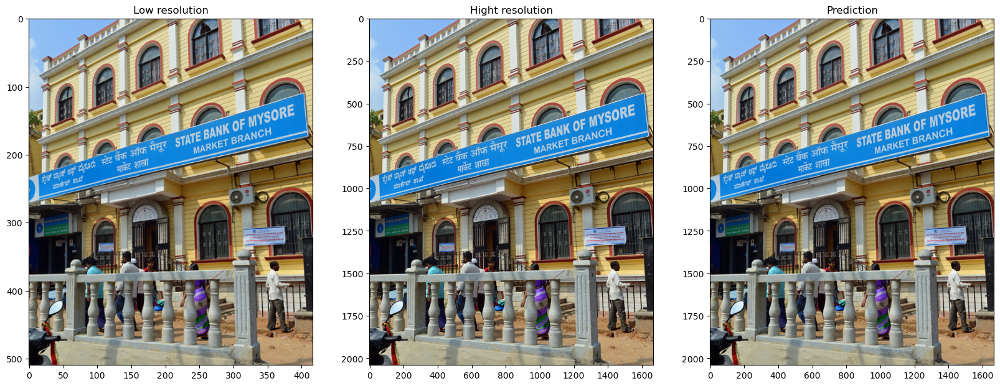

<Figure size 640x480 with 0 Axes>

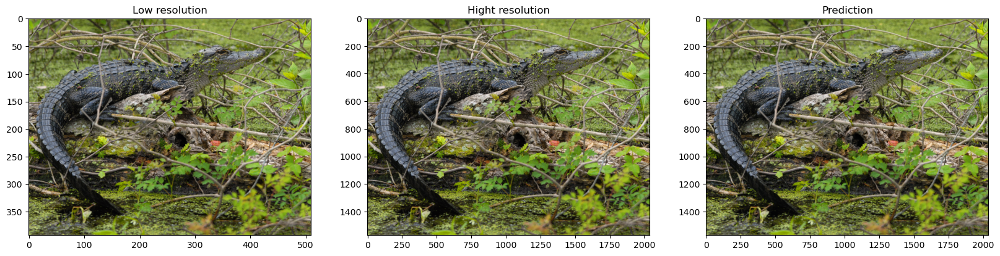

<Figure size 640x480 with 0 Axes>

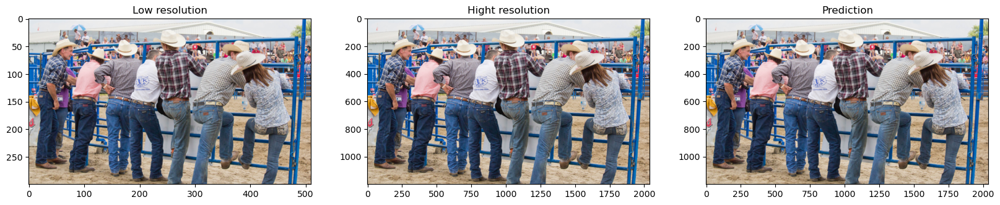

<Figure size 640x480 with 0 Axes>

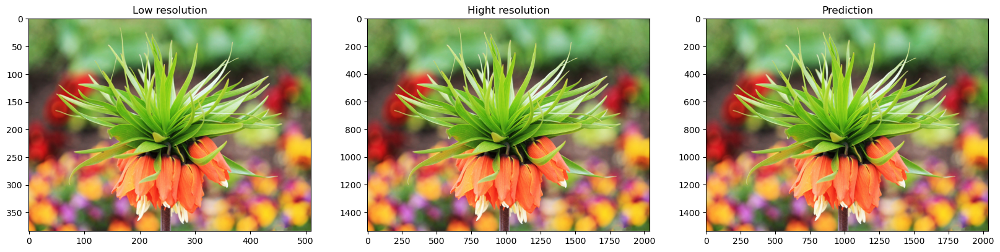

<Figure size 640x480 with 0 Axes>

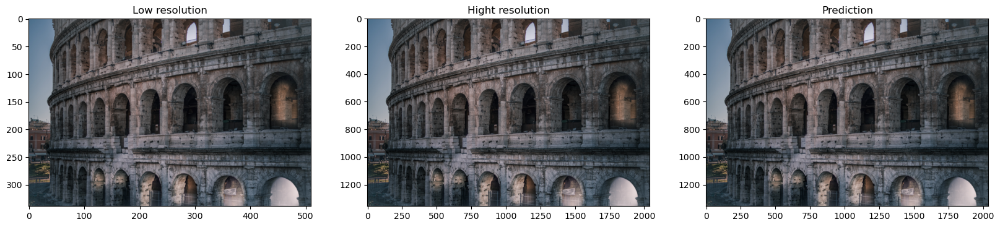

<Figure size 640x480 with 0 Axes>

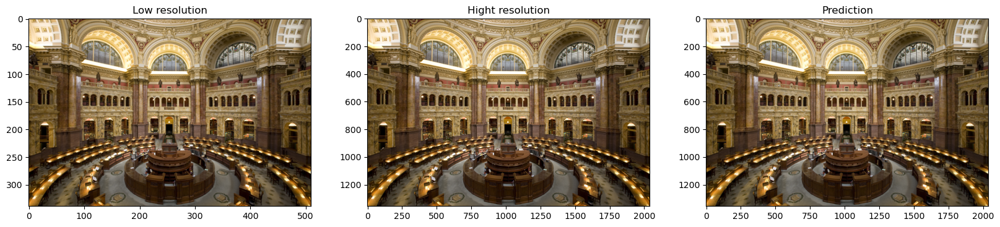

<Figure size 640x480 with 0 Axes>

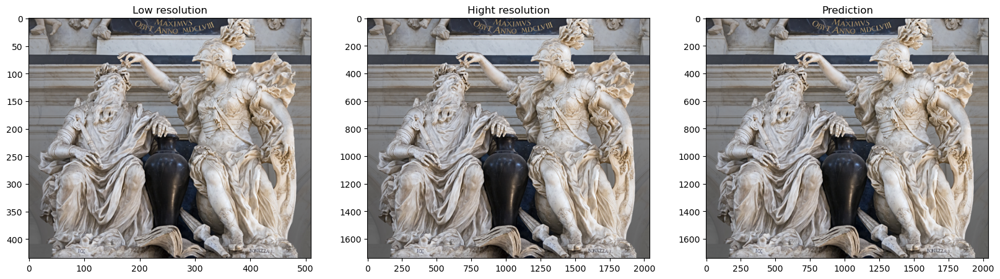

<Figure size 640x480 with 0 Axes>

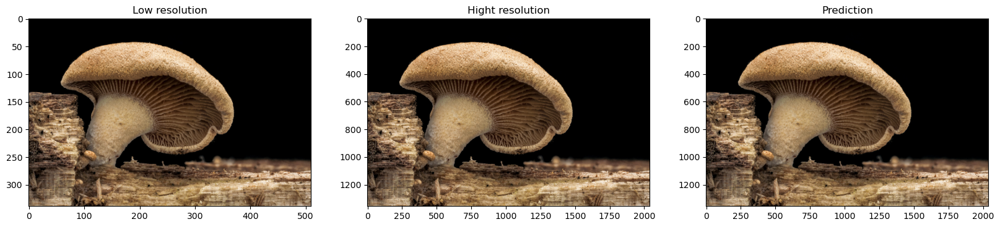

<Figure size 640x480 with 0 Axes>

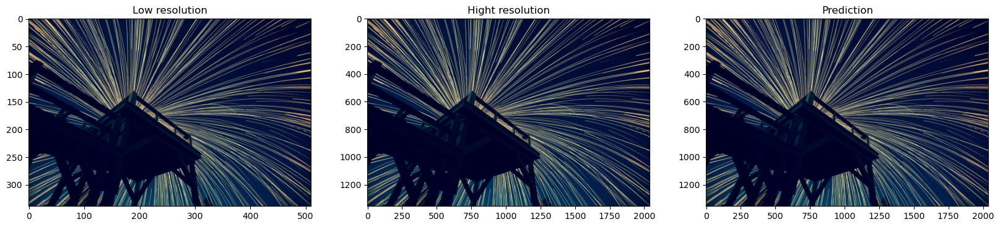

<Figure size 640x480 with 0 Axes>

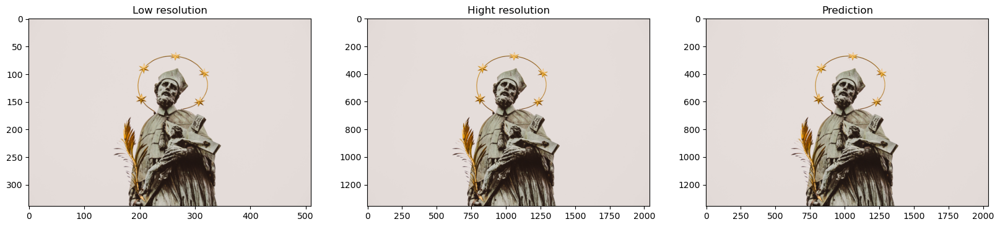

<Figure size 640x480 with 0 Axes>

In [106]:
def plot_results(lowres, preds, highres):     
    """
    Displays low resolution image and super resolution image
    """
    plt.figure(figsize=(20, 10))
    plt.subplot(131), plt.imshow(lowres), plt.title("Low resolution")
    plt.subplot(132), plt.imshow(highres), plt.title("Hight resolution")
    plt.subplot(133), plt.imshow(preds/255.0), plt.title("Prediction")
    plt.show()
    plt.savefig("wdsr_b_res.png")

for lr, hr in val_ds.take(10):
    lr = lr[0]
    hr = hr[0]

 #   lowres = tf.image.random_crop(lowres, (64, 64, 3))
    lr = tf.expand_dims(lr, 0)
    sr = wdsr_b_model.wdsr_model(lr)
    sr = sr[0]
    sr = tf.cast(sr, tf.float32)
    lr = lr[0]
    
    plot_results(lr, sr, hr)